# Установка зависимостей

In [79]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['image.cmap'] = 'gray'
from google.colab.patches import cv2_imshow

# Загрузка фотографий

In [110]:
animals = cv2.imread('/content/animals.jpg')
cars = cv2.imread('/content/cars.jpg')
apples = cv2.imread('/content/apples.jpg')

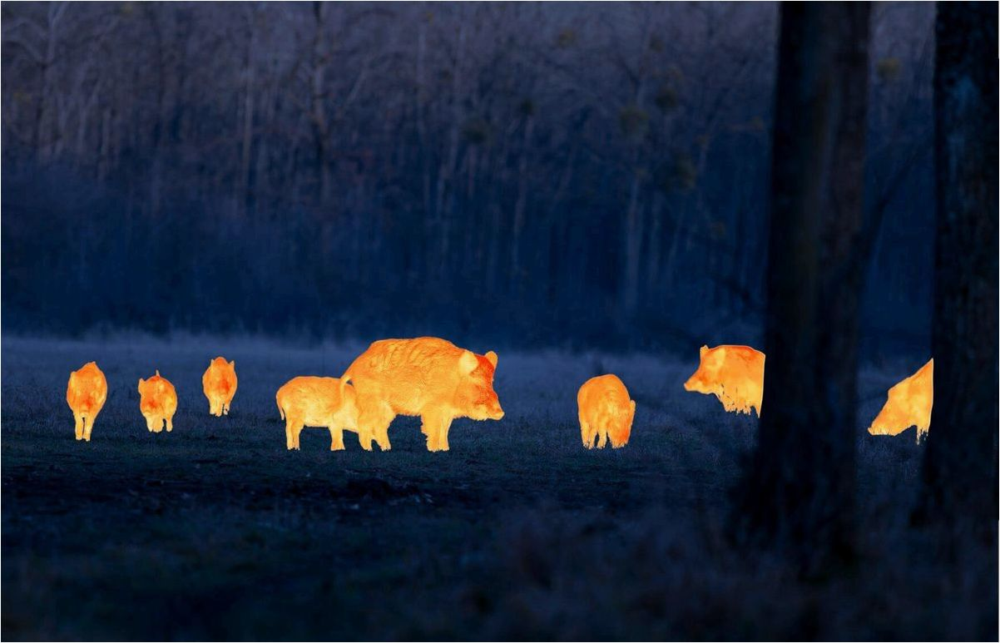

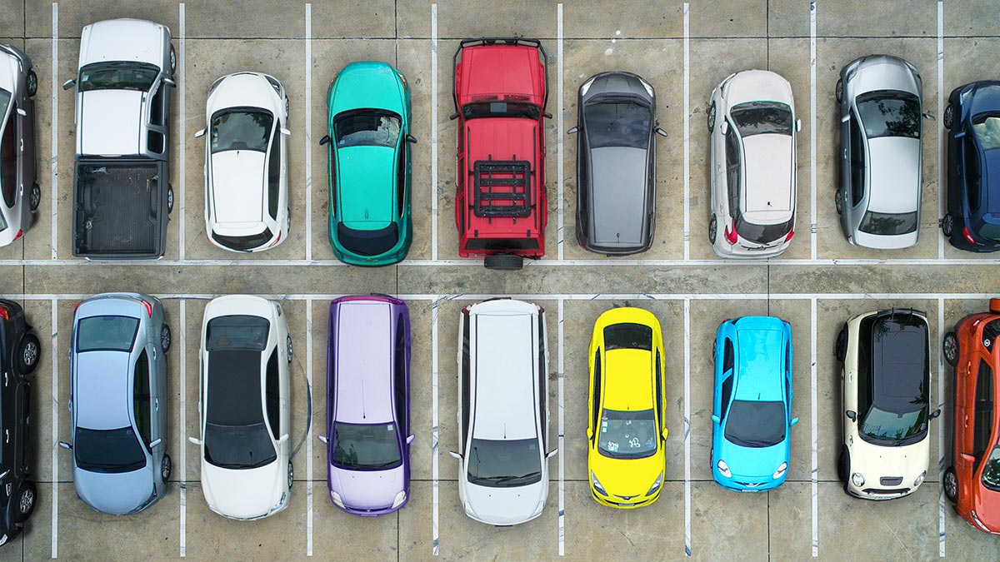

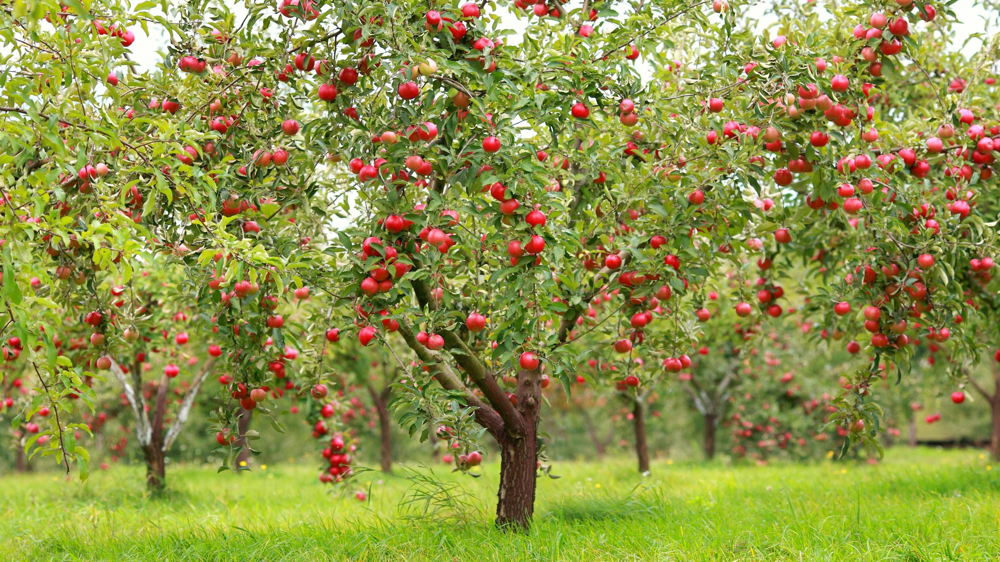

In [111]:
cv2_imshow(animals) #формат BGR
cv2_imshow(cars) #формат BGR
cv2_imshow(apples) #формат BGR

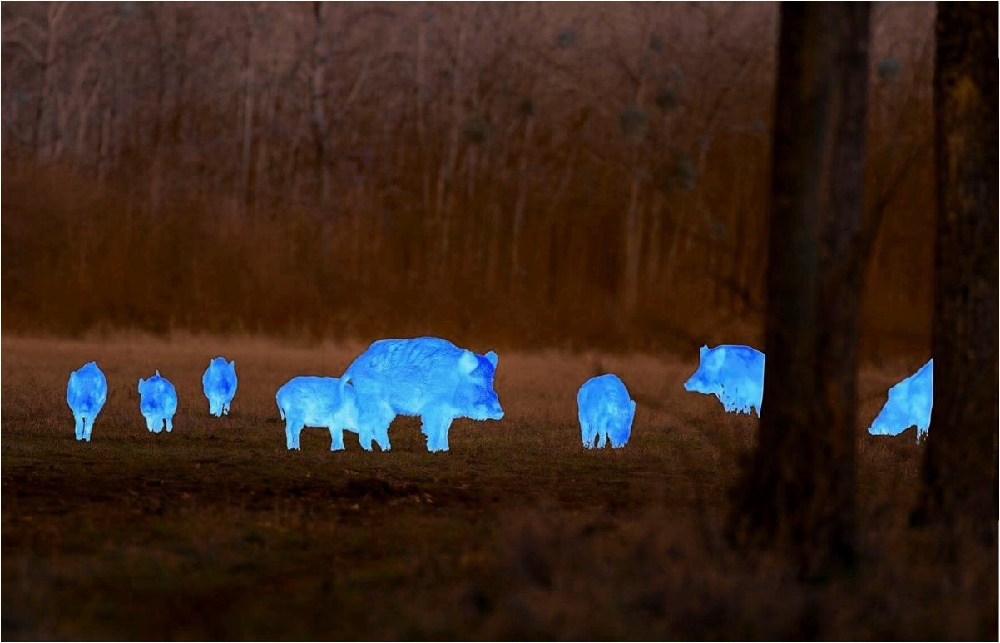

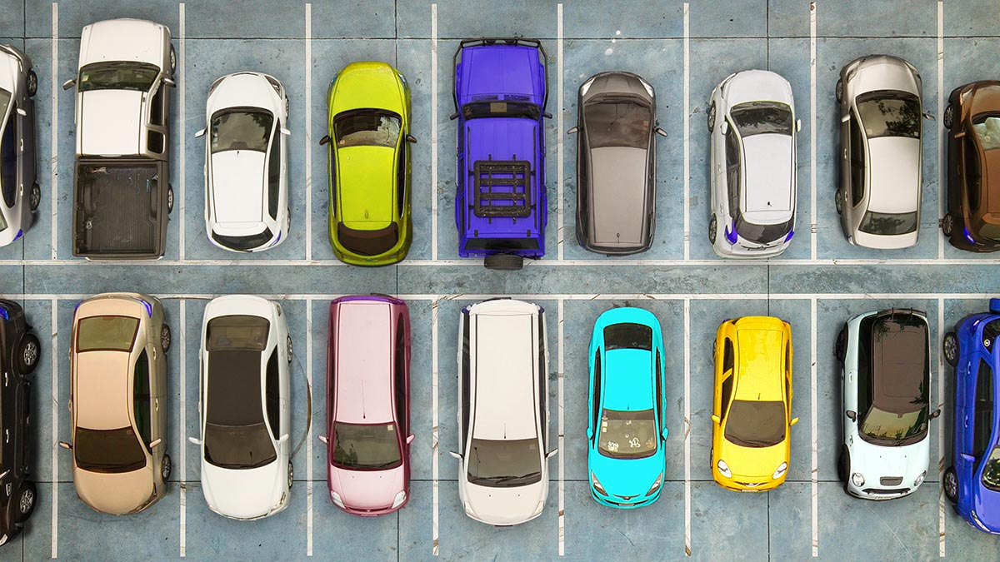

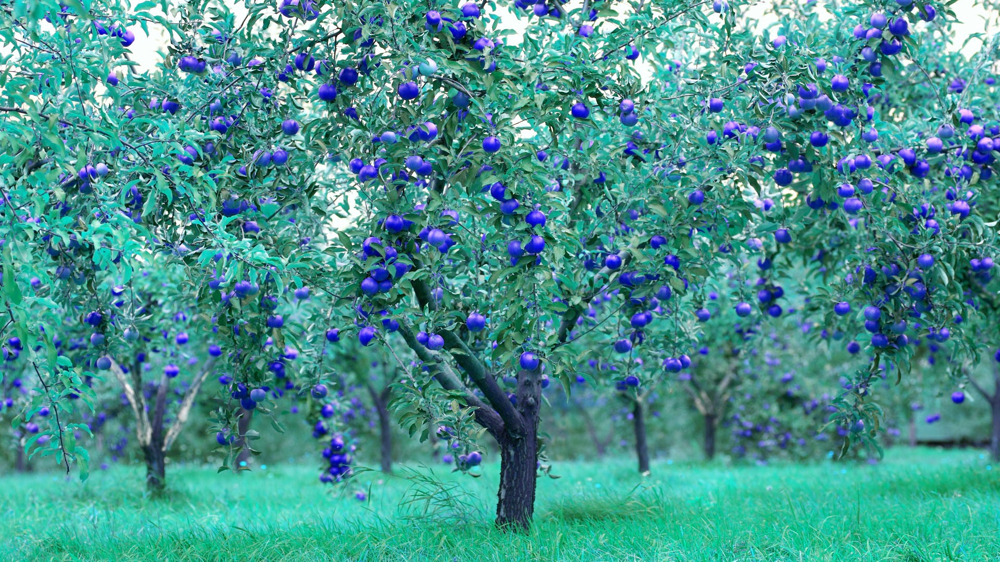

In [112]:
animals_rgb = cv2.cvtColor(animals, cv2.COLOR_BGR2RGB)
cv2_imshow(animals_rgb) #формат RGB
cars_rgb = cv2.cvtColor(cars, cv2.COLOR_BGR2RGB)
cv2_imshow(cars_rgb) #формат RGB
apples_rgb = cv2.cvtColor(apples, cv2.COLOR_BGR2RGB)
cv2_imshow(apples_rgb) #формат RGB

In [83]:
type(animals)

numpy.ndarray

# Вспомогательные функции

In [84]:
def select_colorsp(img, colorsp='gray'):
    '''! Функция, определяющая цветовое пространство, где
    :param img: изображение в формате numpy.ndarray,
    :param colorsp: пространство цветов (по умолчанию - gray),
    return channels[colorsp]: пространство цветов'''
    # Конвертация BGR в RGB
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Преобразование в оттенки серого.
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Разделить RGB
    red, green, blue = cv2.split(img)
    # Преобразование в HSV
    im_hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    # Разделение HSV
    hue, sat, val = cv2.split(im_hsv)
    # Запись каналов в словаре
    channels = {'gray':gray, 'red':red, 'green':green,
                'blue':blue, 'hue':hue, 'sat':sat, 'val':val}

    return channels[colorsp]

In [85]:
def display(img1, img2, name_l='Image №1', name_r='Image №2', figsize=(10,7)):
    '''! Функция вывода двух картинок на экран друг над другом,
    :param img1: изображение №1,
    :param img2: изображение №2,
    :param figsize: размер изображения'''
    plt.figure(figsize=figsize)
    plt.subplot(121)
    plt.imshow(img1)
    plt.title(name_l)
    plt.axis(False)
    plt.subplot(122)
    plt.imshow(img2)
    plt.title(name_r)
    plt.axis(False)
    '''
    #Для отображения фотографий друг над другом
    plt.figure(figsize=figsize)
    plt.imshow(img1, cmap='gray')
    plt.title("Image №1")
    plt.axis(False)
    plt.figure(figsize=figsize)
    plt.imshow(img2, cmap='gray')
    plt.title("Image №2")
    plt.axis(False)
    plt.show()'''

In [86]:
def threshold(img, thresh=127, mode='inverse'):
    '''! Функция, возвращающая изображение, где все пиксели, которые темнее
    thresh  заменяются на 0, светлее - на 255,
    :param img: изображение,
    :param thresh: пороговое значение яркости пикселей,
    :param mode: режим работы функции,
    :return threshold_image: черно-белое изображение'''
    img_buf = img.copy()
    if mode == 'direct':
        # Если пиксель больше порога (светлее), то 255, в противном случае - 0
        thresh_mode = cv2.THRESH_BINARY
    elif mode == 'inverse':
        # Если пиксель больше порога (светлее), то 0, в противном случае - 255
        thresh_mode = cv2.THRESH_BINARY_INV
    ret, threshold_image = cv2.threshold(img_buf, thresh, 255, thresh_mode)
    return threshold_image

In [87]:
def get_bboxes(img):
    '''! Функция, определяющая границы ограничительных рамок, где
    :param img: изображение,
    :return bboxes: массив с координатами огр. рамок'''
    # Определение контуров объектов на фотографии
    contours, hierarchy = cv2.findContours(img, cv2.RETR_LIST,
                                           cv2.CHAIN_APPROX_SIMPLE)
    # Сортировка контуров по площади в порядке ее убывания
    sorted_cnt = sorted(contours, key=cv2.contourArea, reverse = True)
    # Удаление контура с максимальной площадью - самый внешний контур.
    sorted_cnt.remove(sorted_cnt[0])
    bboxes = []
    for cnt in sorted_cnt:
        x,y,w,h = cv2.boundingRect(cnt)
        cnt_area = w * h
        bboxes.append((x, y, x+w, y+h))
    return bboxes

In [88]:
def draw_annotations(img, bboxes, thickness=2, color=(255,0,0)):
    '''! Функция, отображающая ббоксы на изображении, где
    :param img: изображение,
    :param bboxes: массив с координатами ббоксов,
    :param thickness: толщина рамки,
    :param color: цвет рамки в формате RGB,
    :return annotations: фото с нарисованными ббоксами'''
    annotations = img.copy()
    for box in bboxes:
        tlc = (box[0], box[1])
        brc = (box[2], box[3])
        cv2.rectangle(annotations, tlc, brc, color, thickness, cv2.LINE_AA)
    return annotations

In [89]:
def create_color_mask(img, lower=[0,0,0], upper=[0,255,255]):
    '''! Функция создания цветовой маски, где
    :param img: изображение,
    :param lower: нижняя граница цветов,
    :param upper: верхняя граница цветов,
    :return inv_mask: инвертированная маска цветов'''
    img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
    low = np.array(lower)
    up = np.array(upper)
    mask = cv2.inRange(img_hsv, low, up)
    inv_mask = 255 - mask
    return inv_mask

Морфологические операции — это один из методов обработки изображений, который обрабатывает изображение на основе формы.


1.   Эрозия (cv2.erode)- на выходе должно получиться более тонкое изображение, чем исходное;
2.   Расширение (cv2.dilate)-  на выходе должно получиться более толстое изображение, чем исходное
3.   Открытие (cv2.morphologyEx(..., cv2.MORPH_OPEN, ...)) - открытие включает эрозию с последующим расширением внешней поверхности (переднего плана) изображения. Обычно используется для удаления шума.
4.   Закрытие (cv2.morphologyEx(..., cv2.MORPH_CLOSE, ...)) - pакрытие включает расширение с последующей эрозией внешней поверхности (переднего плана) изображения.



In [90]:
def morph_op(img, mode='open', ksize=5, iterations=1):
    '''! Функция, реализующая морфологические операции, где
    :param img: изображение,
    :param mode: режим (эрозия, расширение, открытие и закрытие),
    :param ksize: размер ядра,
    :param iterations: кол-во итераций'''
    im = img.copy()
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(ksize, ksize))
    if mode == 'open':
        morphed = cv2.morphologyEx(im, cv2.MORPH_OPEN, kernel, iterations=1)
    elif mode == 'close':
        morphed = cv2.morphologyEx(im, cv2.MORPH_CLOSE, kernel, iterations=1)
    elif mode == 'erode':
        morphed = cv2.erode(im, kernel)
    elif mode == 'dilate':
        morphed = cv2.dilate(im, kernel)
    return morphed

In [91]:
def get_filtered_bboxes(img, min_area_ratio=0.001):
    '''! Функция для фильтрации ббоксов по площади (удаление наименьших), где
    :param img: изображение,
    :min_area_ratio:  не учитываем ббоксы,
              площадь которых составляет min_area_ratio изображения'''
    contours, hierarchy = cv2.findContours(img, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
    # Сортировка контуров по площади (от большей к меньшей)
    sorted_cnt = sorted(contours, key=cv2.contourArea, reverse = True)
    # Удаление контура с максимальной площадью - самый внешний контур
    sorted_cnt.remove(sorted_cnt[0])
    # Массив для хранения отфильтрованных ббоксов
    bboxes = []
    # Область изображения
    im_area = img.shape[0] * img.shape[1]
    for cnt in sorted_cnt:
        x, y, w, h = cv2.boundingRect(cnt)
        cnt_area = w * h
        # Удаление мелких ббоксов
        if cnt_area > min_area_ratio * im_area:
            bboxes.append((x, y, x + w, y + h))
    return bboxes

# Автоматическая разметка
План реализации автоматической разметки фотографий:


1.   Выбор цветового пространства;
2.   Конвертация в черно-белое изображение с помощью порогового значения;
3.   Выполнение морфологической операции;
4.   Поиск конутров и их отображение (анализ контуров для поиска ббоксов, фильтрация ненужных контуров, отображение ббоксов)
5.   Сохранение в требуемом формате.



## Кабаны
Названия переменных:



*   animals_rgb - изображение кабанов в формате RGB;
*   thresh_animals - черно-белое изображение кабанов;
*   morphed_animals - изображение кабанов после применения морфологических операций.

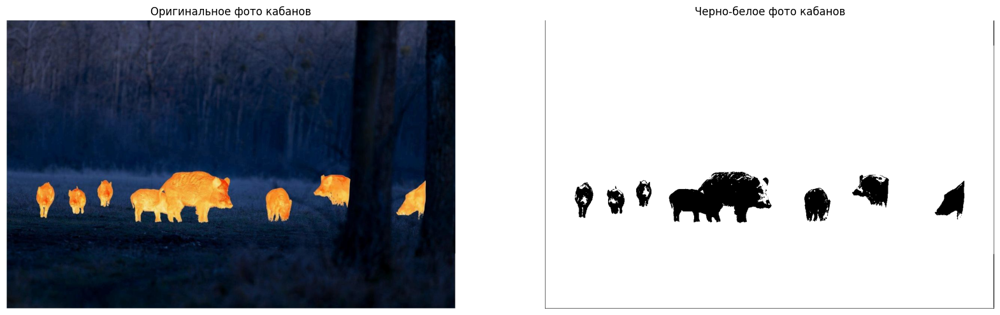

In [92]:
# Выбираем цветовое пространство.
gray_animals = select_colorsp(animals_rgb)
# Черно-белые кабаны
thresh_animals = threshold(gray_animals, thresh=110)
# Отображение фото
display(animals_rgb, thresh_animals,
        name_l='Оригинальное фото кабанов',
        name_r='Черно-белое фото кабанов',
        figsize=(20,14))
bboxes = get_bboxes(thresh_animals)
ann_thresh_animals = draw_annotations(animals_rgb, bboxes, thickness=5, color=(255,0,0))

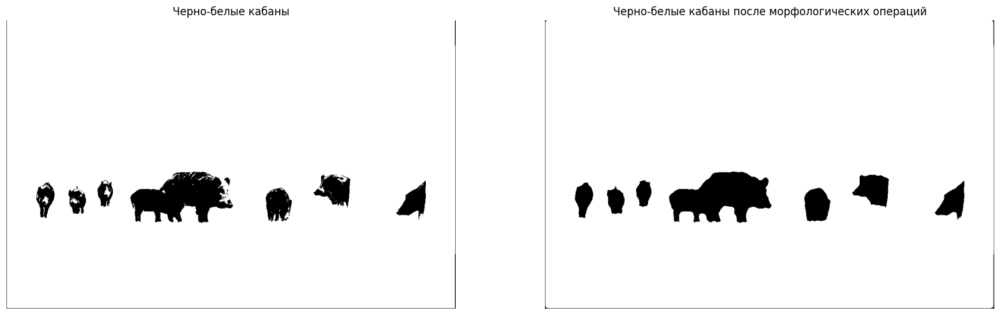

In [93]:
# Выполняем морфологическую операцию.
morphed_animals = morph_op(thresh_animals, mode='open', ksize=15, iterations=5)


display(thresh_animals, morphed_animals,
        name_l='Черно-белые кабаны',
        name_r='Черно-белые кабаны после морфологических операций',
        figsize=(20,14))

Видно улучшение внутри контуров животных

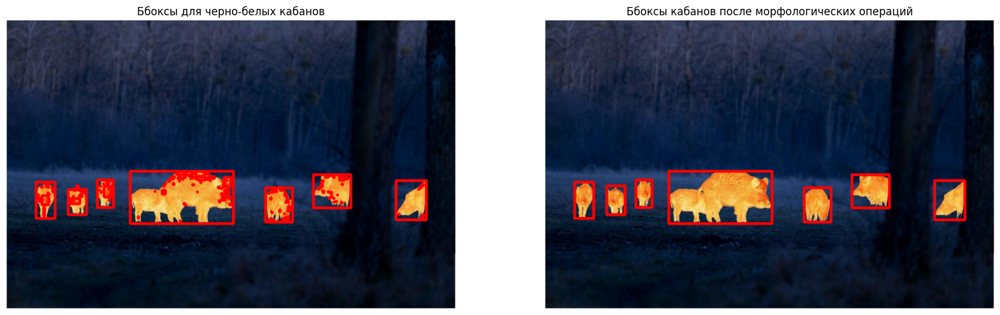

In [94]:
bboxes = get_bboxes(morphed_animals)
ann_morphed_animals = draw_annotations(animals_rgb, bboxes, thickness=5, color=(255,0,0))

# Display.
display(ann_thresh_animals, ann_morphed_animals,
        name_l='Ббоксы для черно-белых кабанов',
        name_r='Ббоксы кабанов после морфологических операций',
        figsize=(20,14))

С помощью морфологических операуий были убраны все лишние ббоксы

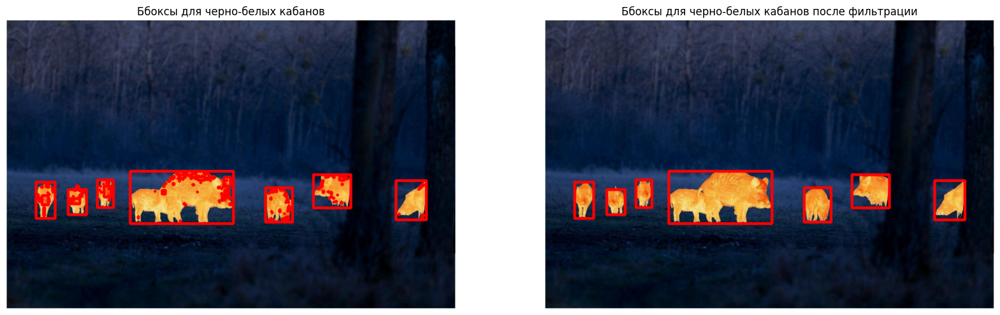

In [95]:
bboxes = get_filtered_bboxes(thresh_animals, min_area_ratio=0.001)
filtered_ann_animals = draw_annotations(animals_rgb, bboxes, thickness=5, color=(255,0,0))

# Display.
display(ann_thresh_animals, filtered_ann_animals,
        name_l='Ббоксы для черно-белых кабанов',
        name_r='Ббоксы для черно-белых кабанов после фильтрации',
        figsize=(20,14))

С помощью фильтрации я добилась того же результата, что и при использовании морфологических операций

## Яблоки

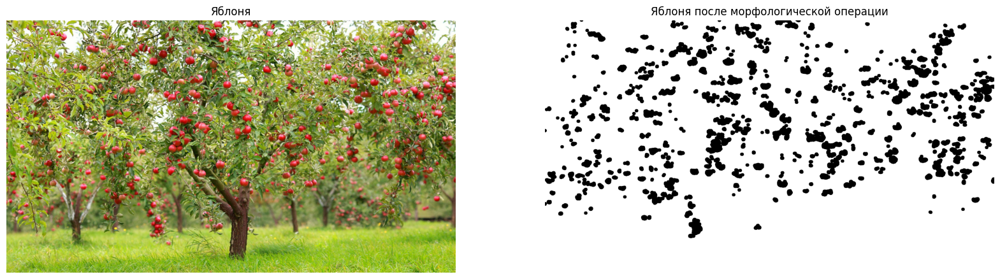

In [96]:
mask_apples = create_color_mask(apples,
                              lower=[0, 211, 111],
                              upper=[16, 255, 255])

morphed_apples = morph_op(mask_apples, mode='erode', ksize=15, iterations=5)

display(apples_rgb, morphed_apples,
        name_l='Яблоня',
        name_r='Яблоня после морфологической операции',
        figsize=(20,14))

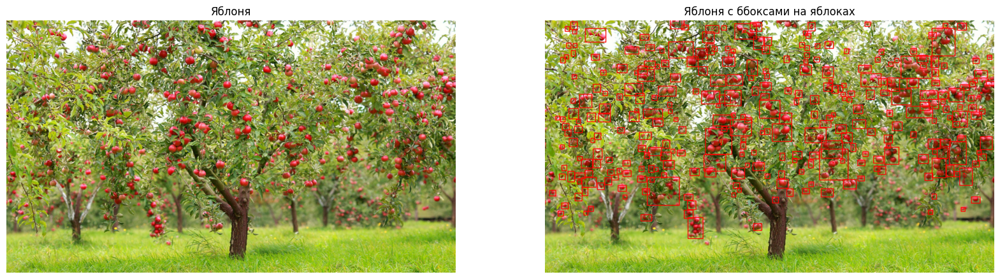

In [97]:
bboxes = get_bboxes(morphed_apples)
morphed_ann_apples = draw_annotations(apples_rgb, bboxes)
display(apples_rgb, morphed_ann_apples,
        name_l='Яблоня',
        name_r='Яблоня с ббоксами на яблоках',
        figsize=(20,14))

## Машины

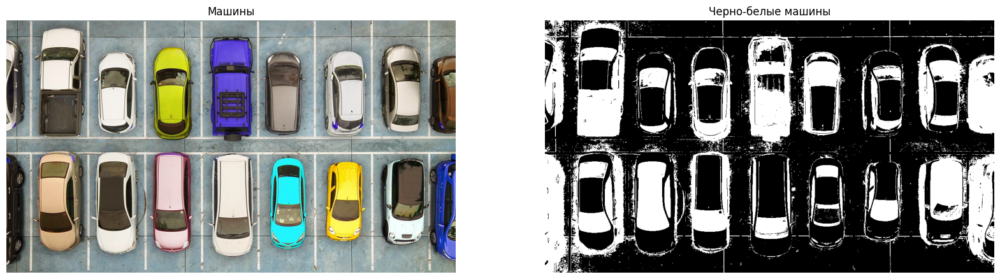

In [119]:
gray_cars = select_colorsp(cars)
threshold_cars = threshold(gray_cars, thresh=120, mode='inverse')
display(cars, threshold_cars,
        name_l='Машины',
        name_r='Черно-белые машины',
        figsize=(20,14))

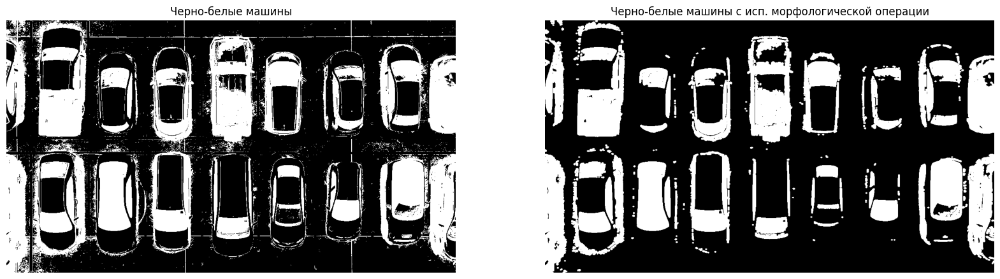

In [131]:
morphed_cars = morph_op(threshold_cars, mode='open', ksize=5, iterations=15)
display(threshold_cars, morphed_cars,
        name_l='Черно-белые машины',
        name_r='Черно-белые машины с исп. морфологической операции',
        figsize=(20,14))

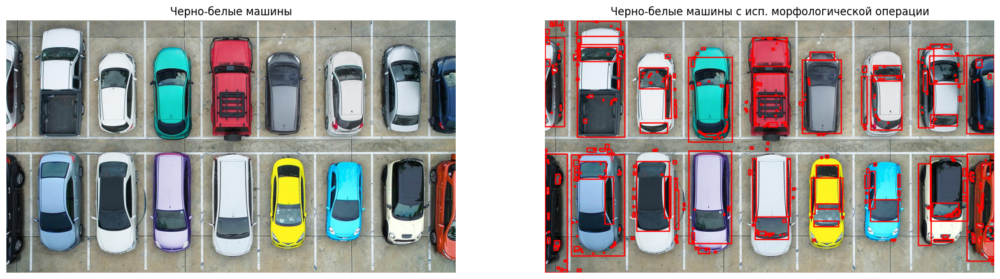

In [132]:
bboxes = get_bboxes(morphed_cars)
morphed_ann_cars = draw_annotations(cars_rgb, bboxes)
display(cars_rgb, morphed_ann_cars,
        name_l='Черно-белые машины',
        name_r='Черно-белые машины с исп. морфологической операции',
        figsize=(20,14))

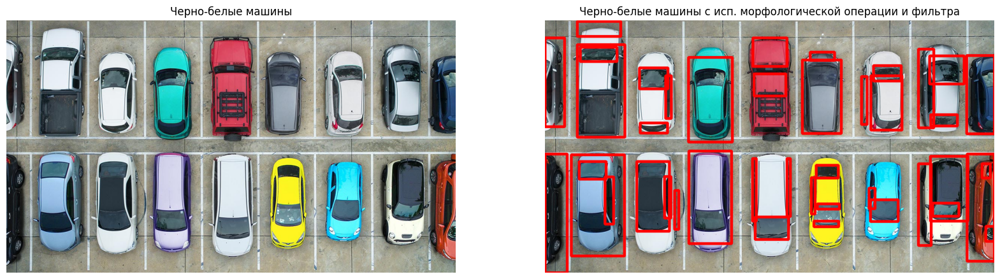

In [135]:
bboxes = get_filtered_bboxes(morphed_cars, min_area_ratio=0.001)
filtered_ann_cars = draw_annotations(cars_rgb, bboxes, thickness=5, color=(255,0,0))
display(cars_rgb, filtered_ann_cars,
        name_l='Черно-белые машины',
        name_r='Черно-белые машины с исп. морфологической операции и фильтра',
        figsize=(20,14))

Из-за разного цвета машин разметка получилась не совсем точной